In [1]:
import os
import numpy as np
import pandas as pd
import geopandas as gpd
import contextily as cx
import matplotlib.pyplot as plt
from matplotlib.ticker import StrMethodFormatter, FormatStrFormatter

from city import City
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

/home/francisco/.pyenv/versions/3.9.15/envs/phd/lib/python3.9/site-packages/geopandas/_compat.py:112: UserWarning: The Shapely GEOS version (3.8.0-CAPI-1.13.1 ) is incompatible with the GEOS version PyGEOS was compiled with (3.10.1-CAPI-1.16.0). Conversions between both will be slow.
  warnings.warn(


In [2]:
# PATHS to read the models
local_folder = "/home/francisco/Developer/local_data" #"/home/francisco/Developer/local_data" HERE type local machine folder
cloud_folder = "/run/user/1000/gvfs/sftp:host=sftp.tudelft.nl,user=%20fgarridovalenz/staff-umbrella/phdfrancisco/Repos/urban_behavior" #/home/francisco/Mounts/Phd/Repos/urban_behavior" Here type the origin of data

municipality_csv = f"{cloud_folder}/zone_lists/phd_list.csv"

In [3]:
df_municipalities = pd.read_csv(municipality_csv)
#gmt = gpd.read_file('GMT/CBS_gemeenten2022.shp')

muni_cols = ['name',
             'region',
             'country',
             'country_code',
             'population',
             'surface',
             'images',
             'executed',
             'processed',
             'aggregated']
df_municipalities = df_municipalities.loc[:, muni_cols]

# Adding extra info:
df_municipalities['pop_density'] =  df_municipalities['population']/df_municipalities['surface']
df_municipalities['img_density'] =  df_municipalities['images']/df_municipalities['surface']
df_municipalities['folder'] = df_municipalities.apply(lambda row: row['name'] + f"_{row['country_code']}", axis = 1)
df_municipalities.describe()

,population,surface,images,executed,processed,aggregated,pop_density,img_density
count,344.000000,344.000000,3.440000e+02,344.000000,344.000000,344.000000,344.000000,344.000000
mean,51155.869186,97.684855,1.073541e+05,0.828488,0.697674,0.575581,901.150479,1475.129812
std,75716.975526,89.222887,1.369633e+05,0.434922,0.502351,0.615719,1066.280554,1496.148738
min,943.000000,7.030000,0.000000e+00,-1.000000,-1.000000,-1.000000,23.283951,0.000000
25%,22317.500000,33.740000,0.000000e+00,1.000000,0.000000,0.000000,245.422769,0.000000
50%,31878.000000,74.170000,7.736650e+04,1.000000,1.000000,1.000000,476.325777,1101.783684
75%,51253.000000,127.840000,1.515140e+05,1.000000,1.000000,1.000000,1173.762058,2067.467084
max,905234.000000,523.010000,1.253895e+06,2.000000,1.000000,2.000000,6707.034566,7576.404834


In [4]:
# SCRIPT SUMMARY
collected_ok = len(df_municipalities.loc[df_municipalities['executed'] == 1])
collected_error = len(df_municipalities.loc[df_municipalities['executed'] < 0])
processed_ok = len(df_municipalities.loc[df_municipalities['processed'] == 1])
processed_error = len(df_municipalities.loc[df_municipalities['processed'] < 0])
aggregated_ok = len(df_municipalities.loc[df_municipalities['aggregated'] == 1])
aggregated_error = len(df_municipalities.loc[df_municipalities['aggregated'] < 0])

summary_dict = {'Data collection': {'DONE': collected_ok, 
                                    'ERROR': collected_error, 
                                    'TODO': 344-collected_ok-collected_error, 
                                    'TOTAL': 344},
                'Data processing': {'DONE': processed_ok, 
                                    'ERROR': processed_error, 
                                    'TODO': 344-processed_ok-processed_error, 
                                    'TOTAL': 344},
                'Data aggregation': {'DONE': aggregated_ok, 
                                    'ERROR': aggregated_error, 
                                    'TODO': 344-aggregated_ok-aggregated_error, 
                                    'TOTAL': 344}}

summ = pd.DataFrame(summary_dict)
summ.head()

,Data collection,Data processing,Data aggregation
DONE,281,247,215
ERROR,4,7,21
TODO,59,90,108
TOTAL,344,344,344


In [5]:
# Municipalities ready for analysis
ready_municipalities = df_municipalities.copy()
ready_municipalities = ready_municipalities.loc[ready_municipalities['aggregated'] == 1]

In [6]:
def histogram(df, col,  bins = 70, title = "", xtitle = "", ytitle = "", figsize = (10,6), color = '#86bf91', rwidth=0.85):
    fig, ax = plt.subplots(figsize = figsize)
    df[col].plot(kind = "hist", 
                 bins = bins, 
                 color=color,
                 edgecolor = '#000000', 
                 linewidth = 0.5,
                 rwidth=0.8)
    # General 
    #title_func = lambda x: max(-x**2/20 + 5*x/2, 31.25)
    if title != "":    
        ax.set_title(title, weight='bold', size= 1.4*figsize[0])
    ax.tick_params(left = True, bottom = True, pad = 5, width = 1)
    
    # X axis
    ax.set_xlabel(xtitle, size = figsize[0]) #, weight='bold'
    #plt.xticks(np.arange(0, 1000001, 100000))
    #ax.set_xlim(0, 1000000)

    # Y axis
    ax.set_ylabel(ytitle, size = figsize[0])
    #plt.yticks(np.arange(0, max(y), 2))
    #ax.set_ylim(0,110)

    #for ax, spine in ax.spines.items():
    #    spine.set_visible(True)

    ax.grid(axis = 'y')
        
    plt.show()

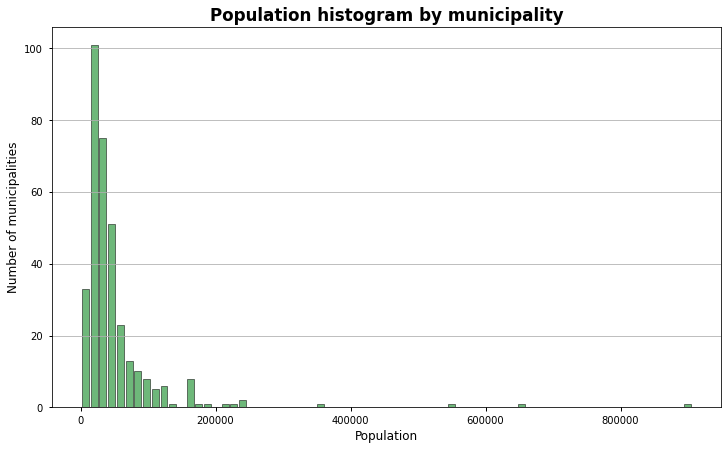

In [7]:
histogram(df_municipalities, col = 'population', bins = 70, 
          title = "Population histogram by municipality",
          xtitle = "Population",
          ytitle = "Number of municipalities",
          figsize = (12,7),
          color = '#6EB87A',
          rwidth = 0.85)

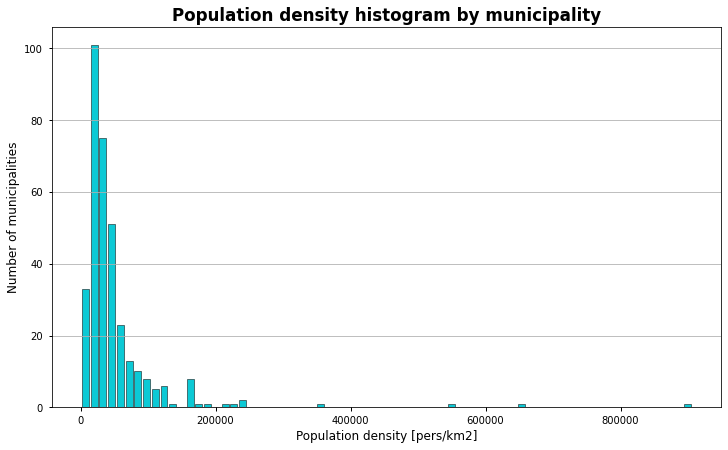

In [8]:
histogram(df_municipalities, col = 'population', bins = 70, 
          title = "Population density histogram by municipality",
          xtitle = "Population density [pers/km2]",
          ytitle = "Number of municipalities",
          figsize = (12,7),
          color = '#0cc9d5',
          rwidth = 0.85)

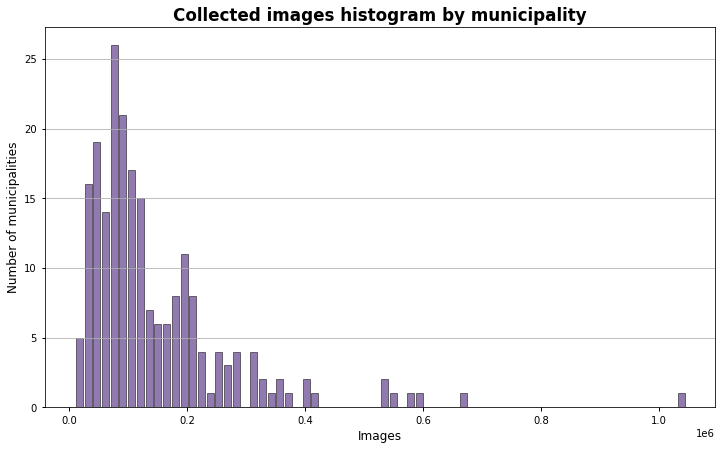

In [9]:
histogram(ready_municipalities, col = 'images', bins = 70, 
          title = "Collected images histogram by municipality",
          xtitle = "Images",
          ytitle = "Number of municipalities",
          figsize = (12,7),
          color = '#907AB0',
          rwidth = 0.85)

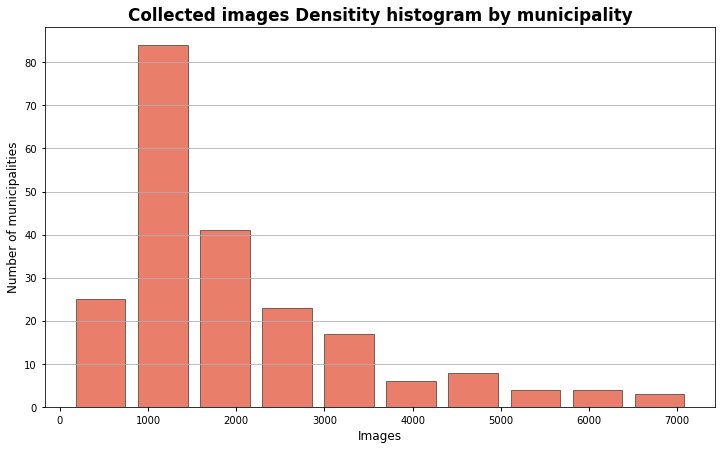

In [10]:
histogram(ready_municipalities, col = 'img_density', bins = 10, 
          title = "Collected images Densitity histogram by municipality",
          xtitle = "Images",
          ytitle = "Number of municipalities",
          figsize = (12,7),
          color = '#E97E6B',
          rwidth = 0.85)

In [11]:
print(ready_municipalities['images'].sum())
print('---')
print(ready_municipalities.loc[ready_municipalities['images'] == ready_municipalities['images'].max()])
print('---')
print(ready_municipalities.loc[ready_municipalities['images'] == ready_municipalities['images'].min()])
print('---')


31069682
---
         name        region          country country_code  population  \
62  Rotterdam  Zuid-Holland  the Netherlands           NL      656050   

    surface   images  executed  processed  aggregated  pop_density  \
62   217.55  1045026         1          1           1  3015.628591   

    img_density        folder  
62  4803.612963  Rotterdam_NL  
---
          name      region          country country_code  population  surface  \
255  Rozendaal  Gelderland  the Netherlands           NL        1753     27.9   

     images  executed  processed  aggregated  pop_density  img_density  \
255    9768         1          1           1    62.831541   350.107527   

           folder  
255  Rozendaal_NL  
---


In [13]:
# Make a temp folder with cities
import process_function as pf

if True:
    for i,c in ready_municipalities.iterrows():

        zone_local_folder = f"{local_folder}/zones/{ready_municipalities['folder'][i]}"
        boundary_folder = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/boundary"
        edges_folder = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/network/edges"
        cells_folder = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/cells"
        pickle_file = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/file.pkl"
        obj_file = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/obj.pkl"

        if not os.path.exists(zone_local_folder):
            print(f"say \"Creating folder for {ready_municipalities['folder'][i]}\"")

            zone_cloud_folder = f"{cloud_folder}/zones/{ready_municipalities['folder'][i]}"
            c_aux = City(zone_cloud_folder, True, False, True, cells = True, boundary = True, edges = True)

            os.mkdir(zone_local_folder)
            writer = open(f"{zone_local_folder}/crs.txt", 'w')
            writer.write(str(c_aux.crs))
            writer.close()

            # Create cells folder and store it
            os.mkdir(f"{zone_local_folder}/cells")
            c_aux.cells.to_file(f"{zone_local_folder}/cells/cells.geojson")

            os.mkdir(f"{zone_local_folder}/boundary")
            c_aux.boundary.to_file(f"{zone_local_folder}/boundary/boundary.geojson")

            os.mkdir(f"{zone_local_folder}/network")
            os.mkdir(f"{zone_local_folder}/network/edges")
            c_aux.edges.to_file(f"{zone_local_folder}/network/edges/edges.geojson")

            print(f"say \"{ready_municipalities['folder'][i]} ready\"")

        elif not os.path.exists(boundary_folder):
            print(f"say \"Adding boundaries to {ready_municipalities['folder'][i]}\"")

            zone_cloud_folder = f"{cloud_folder}/zones/{ready_municipalities['folder'][i]}"
            c_aux = City(zone_cloud_folder, True, False, True, boundary = True)

            os.mkdir(f"{zone_local_folder}/boundary")
            c_aux.boundary.to_file(f"{zone_local_folder}/boundary/boundary.geojson")

            print(f"say \"{ready_municipalities['folder'][i]} ready\"")
        
        elif not os.path.exists(edges_folder):
            print(f"say \"Adding edges to {ready_municipalities['folder'][i]}\"")

            zone_cloud_folder = f"{cloud_folder}/zones/{ready_municipalities['folder'][i]}"
            c_aux = City(zone_cloud_folder, True, False, True, edges = True)

            os.mkdir(f"{zone_local_folder}/network")
            os.mkdir(f"{zone_local_folder}/network/edges")
            c_aux.edges.to_file(f"{zone_local_folder}/network/edges/edges.geojson")

            print(f"say \"{ready_municipalities['folder'][i]} ready\"")
        
        #elif not os.path.exists(pickle_file):
        #    pf.estimate_models(zone_local_folder)
        
        elif not os.path.exists(obj_file):
            pf.estimate_models2(zone_local_folder)

In [9]:
import os
os.system('say ok ok ok ok ok ok ok ok ok ok ok ok ok ok')

0

In [14]:
import pickle
municipalities_obj = {}

for i,c in ready_municipalities.iterrows():
    pickle_file = f"{local_folder}/zones/{ready_municipalities['folder'][i]}/file.pkl"
    with open('file.pkl', 'rb') as file:
        c_aux = pickle.load(pickle_file)
        municipalities_obj[ready_municipalities['folder']]

FileNotFoundError: [Errno 2] No such file or directory: 'file.pkl'

In [13]:
# Ploter
municipalities_to_plot = ['The Hague']
indexes = ready_municipalities.loc[ready_municipalities['name'].isin(municipalities_to_plot)].index.values
plotting_folders = [f"{local_folder}/zones/{ready_municipalities['folder'][i]}" for i in indexes]
c_auxs = [City(zone_folder, True, False, True, cells = True) for zone_folder in plotting_folders]

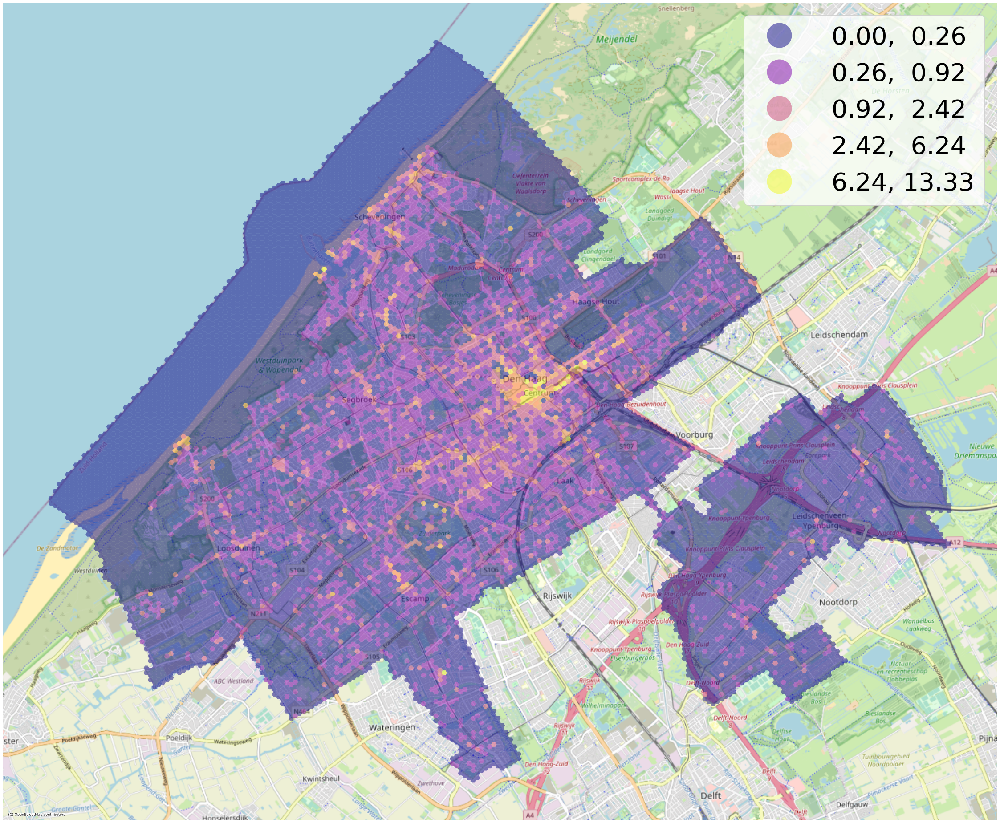

In [14]:
to_plot = 'person_det'
size = 40
fig, ax = plt.subplots(figsize=(size,size))

legend_keys = {'fontsize': size*1.4, 
               'markerscale': size*0.14, 
               'loc':'upper right'}

if len(indexes) > 1:
    crs = 28992
else:
    crs = c_auxs[0].cells_utm.crs

for c_aux in c_auxs:
    c_aux_plot = c_aux.cells_utm.copy()
    #c_aux_plot['h_bound'] = c_aux_plot.apply(lambda row: row['geometry'].bounds[0], axis = 1)
    #c_aux_plot = c_aux_plot.loc[c_aux_plot['h_bound'] > 591200]
    c_aux_plot.to_crs(crs).plot(ax = ax, column = to_plot, zorder = 1, scheme='natural_breaks', cmap = 'plasma', alpha = 0.5, legend = True, legend_kwds = legend_keys)

cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, crs = crs, zorder = 0, alpha = 1)
plt.axis('off')
plt.show()


In [15]:
import concurrent.futures as cf
import process_function as pf

all_cols = []
cities_dict = {}
common_models = {}
aggregated_models = {}
X_common = ['n_nodes', 'm_street', 'bicycle_det', 'car_det', 'bus_det', 'motorcycle_det', 'truck_det',
            'parking meter_det', 'bench_det', 'residential_lu', 'grass_lu', 'forest_lu', 'cemetery_lu'] #'orchard_lu'
X_agg = ['n_nodes', 'm_street', 'bicycle_det', 'car_det', 'bus_det', 'motorcycle_det', 'truck_det', 'parking meter_det', 'bench_det',
        'food_place_amn_agg','education_amn_agg','transportation_amn_agg','financial_amn_agg','entertainment_amn_agg','public_service_amn_agg',
        'facility_amn_agg','waste_amn_agg','other_amn_agg', 'residential_lu', 'grass_lu', 'forest_lu', 'cemetery_lu'] #'orchard_lu'

zone_folders = [f"{local_folder}/zones/{ready_municipalities['folder'][i]}" for i,c in ready_municipalities.iterrows()]

In [16]:
if __name__ == "__main__":
    with cf.ThreadPoolExecutor() as executor:
        results = executor.map(pf.estimate_models2, zone_folders)

starting The Hague_NL ......
starting Amersfoort_NL ......
starting Amstelveen_NL ......
starting Delft_NL ......starting Dordrecht_NL ......
starting Eindhoven_NL ......

starting Gorinchem_NL ......
starting Gouda_NL ......
starting Haarlem_NL ......
starting Halderberge_NL ......
starting Hardenberg_NL ......
starting Harderwijk_NL ......
...... Gouda_NL done
starting Hardinxveld-Giessendam_NL ......
...... Gorinchem_NL done
starting Hattem_NL ......
...... Delft_NL done
starting Heemskerk_NL ......
...... Haarlem_NL done
starting Heemstede_NL ......
...... Hardinxveld-Giessendam_NL done
starting Heerde_NL ......
...... Amstelveen_NL done
starting Heerenveen_NL ......
...... Hattem_NL done
starting Heerlen_NL ......
...... Heemstede_NL done
starting Heiloo_NL ......
...... Harderwijk_NL done
starting Hellendoorn_NL ......
...... Heemskerk_NL done
starting Hellevoetsluis_NL ......
...... Amersfoort_NL done
starting Helmond_NL ......
...... Heiloo_NL done
starting Hendrik-Ido-Ambacht_

In [ ]:
i = 0
for r in results:
    print(r[0].folder)
    if r[1] == -1:
        print(i)
    cities_dict[i] = r[0]
    i += 1

In [14]:
os.system('say all run successfully')

0

In [ ]:
def add_info_to_cities_db(models_dict, cities):
    betas = []
    tes = []
    for m in models_dict:
        mod = models_dict[m]

        beta = mod.params
        beta = beta.add_prefix('B_')
        beta['ind'] = m
        beta['folder2'] = cities_dict[m].folder
        betas.append(beta)

        t = mod.tvalues
        t = t.add_prefix('t_')
        t['ind'] = m
        t['folder'] = str(cities_dict[m].folder).split("/")[-1]
        tes.append(t)   

    betas_df = pd.concat(betas, axis = 1).T
    tes_df = pd.concat(tes, axis = 1).T 
    df_final = pd.merge(betas_df, tes_df, how = 'left', on = 'ind')

    cities_tmp = cities.copy()
    #cities_tmp['ind'] = cities_tmp.index

    conclusion = pd.merge(cities_tmp, df_final, on = 'folder')
    return conclusion

In [21]:
con_common = add_info(common_models, ready_municipalities)
con_agg = add_info(aggregated_models, ready_municipalities)

In [22]:
con_agg.loc[con_agg['name'] == "The Hague"]

,name,region,country,country_code,population,surface,images,executed,processed,aggregated,pop_density,img_density,folder,B_n_nodes,B_m_street,B_bicycle_det,B_car_det,B_bus_det,B_motorcycle_det,B_truck_det,B_parking meter_det,B_bench_det,B_food_place_agg,B_education_agg,B_transportation_agg,B_financial_agg,B_entertainment_agg,B_public_service_agg,B_facility_agg,B_waste_agg,B_other_agg,B_residential_lu,B_grass_lu,B_forest_lu,B_cemetery_lu,ind,folder2,t_n_nodes,t_m_street,t_bicycle_det,t_car_det,t_bus_det,t_motorcycle_det,t_truck_det,t_parking meter_det,t_bench_det,t_food_place_agg,t_education_agg,t_transportation_agg,t_financial_agg,t_entertainment_agg,t_public_service_agg,t_facility_agg,t_waste_agg,t_other_agg,t_residential_lu,t_grass_lu,t_forest_lu,t_cemetery_lu
0,The Hague,Zuid-Holland,the Netherlands,NL,552995,82.45,589732,1,1,1,6707.034566,7152.601577,The Hague_NL,0.006898,0.000608,0.214743,-0.00348,0.541889,0.803676,0.202029,0.924551,0.673553,0.278103,0.082548,0.057718,0.243942,0.126745,0.115567,0.079709,-0.026204,0.085745,-0.000006,-0.000015,-0.000014,0.000002,0.0,/Users/francisco/Developer/local_data/zones/Th...,4.144522,14.231524,20.254409,-3.719339,8.12414,20.937773,6.65856,2.843161,14.639349,39.215827,2.102838,3.231958,12.271055,5.487043,3.935277,8.93854,-1.901339,3.062131,-3.404148,-4.729339,-4.553829,0.214951


In [23]:
aggregated_models[0].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             person_det   R-squared (uncentered):                   0.438
Model:                            OLS   Adj. R-squared (uncentered):              0.437
Method:                 Least Squares   F-statistic:                              553.4
Date:                Wed, 05 Oct 2022   Prob (F-statistic):                        0.00
Time:                        04:34:55   Log-Likelihood:                         -10876.
No. Observations:               15668   AIC:                                  2.180e+04
Df Residuals:                   15646   BIC:                                  2.196e+04
Df Model:                          22                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
n_nodes                0.0069      0.002      4.145      0.000       0.004       0.010
m_street               0.0006   4.27e-05     14.232      0.000       0.001       0.001
bicycle_det            0.2147      0.011     20.254      0.000       0.194       0.236
car_det               -0.0035      0.001     -3.719      0.000      -0.005      -0.002
bus_det                0.5419      0.067      8.124      0.000       0.411       0.673
motorcycle_det         0.8037      0.038     20.938      0.000       0.728       0.879
truck_det              0.2020      0.030      6.659      0.000       0.143       0.262
parking meter_det      0.9246      0.325      2.843      0.004       0.287       1.562
bench_det              0.6736      0.046     14.639      0.000       0.583       0.764
food_place_agg         0.2781      0.007     39.216      0.000       0.264       0.292
education_agg          0.0825      0.039      2.103      0.035       0.006       0.159
transportation_agg     0.0577      0.018      3.232      0.001       0.023       0.093
financial_agg          0.2439      0.020     12.271      0.000       0.205       0.283
entertainment_agg      0.1267      0.023      5.487      0.000       0.081       0.172
public_service_agg     0.1156      0.029      3.935      0.000       0.058       0.173
facility_agg           0.0797      0.009      8.939      0.000       0.062       0.097
waste_agg             -0.0262      0.014     -1.901      0.057      -0.053       0.001
other_agg              0.0857      0.028      3.062      0.002       0.031       0.141
residential_lu     -5.835e-06   1.71e-06     -3.404      0.001    -9.2e-06   -2.48e-06
grass_lu           -1.515e-05    3.2e-06     -4.729      0.000   -2.14e-05   -8.87e-06
forest_lu          -1.388e-05   3.05e-06     -4.554      0.000   -1.99e-05   -7.91e-06
cemetery_lu         2.298e-06   1.07e-05      0.215      0.830   -1.87e-05    2.32e-05
==============================================================================
Omnibus:                    24160.254   Durbin-Watson:                   1.412
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         19197808.699
Skew:                           9.597   Prob(JB):                         0.00
Kurtosis:                     173.407   Cond. No.                     3.01e+05
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.01e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [24]:
con_aggB = con_agg.copy()
b_cols = []
for col in con_agg.columns:
    if 'B_' in col:
        b_cols.append(col)
        con_aggB[col] = pd.to_numeric(con_agg[col])

In [25]:
con_aggT = con_agg.copy()
t_cols = []
for col in con_agg.columns:
    if 't_' in col:
        t_cols.append(col)
        con_aggT[col] = pd.to_numeric(con_agg[col])

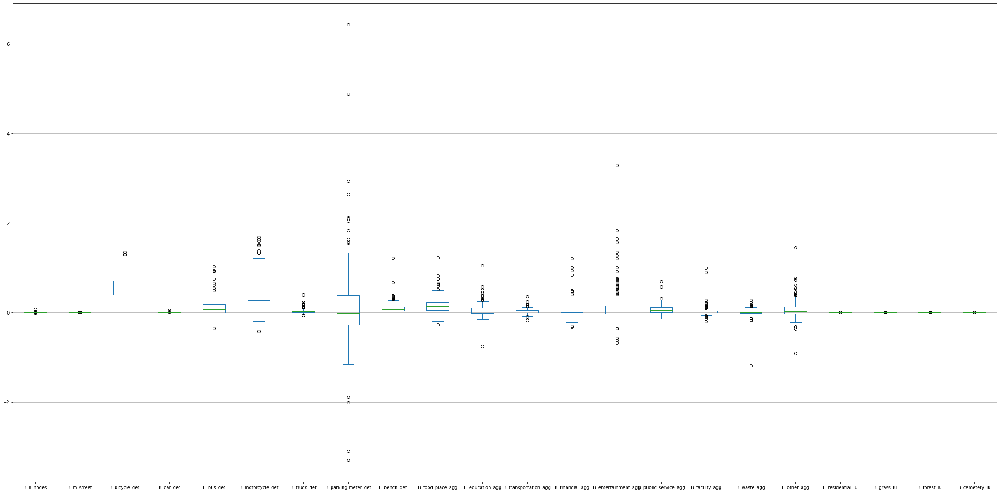

In [33]:
fig, ax = plt.subplots(figsize=(10,2))

con_aggB[b_cols].plot.box(ax = ax, figsize = (40,20))
plt.grid(axis = 'y')

plt.show()

In [34]:
fig, ax = plt.subplots(figsize=(10,2))

con_aggT[t_cols].plot.box(figsize = (40,20))

ax.axhline(y = 1.95, color = 'grey', linestyle = ':')
ax.axhline(y = -1.95, color = 'grey', linestyle = ':')

plt.grid(axis = 'y')

plt.show()

In [29]:
list_dfs_full = []
list_dfs_agg = []
for i in cities_dict:
    list_dfs_full.append(cities_dict[i].cells)
    list_dfs_agg.append(cities_dict[i].get_cells_aggregated())

NL_full = pd.concat(list_dfs_full)
NL_full_clean = NL_full.dropna(axis = 1)
NL_agg = pd.concat(list_dfs_agg)

In [30]:
NL_full.describe()

,cell,area,person_det,bicycle_det,car_det,motorcycle_det,bus_det,train_det,truck_det,boat_det,traffic light_det,fire hydrant_det,stop sign_det,parking meter_det,bench_det,has_data,m_street,n_nodes,charging_station_amn,recycling_amn,fast_food_amn,restaurant_amn,waste_basket_amn,parking_amn,bench_amn,atm_amn,pharmacy_amn,post_box_amn,kindergarten_amn,public_bookcase_amn,toilets_amn,compressed_air_amn,fuel_amn,place_of_worship_amn,drinking_water_amn,animal_shelter_amn,social_facility_amn,pub_amn,cultural_centre_amn,car_wash_amn,training_amn,clinic_amn,photographer_amn,school_amn,childcare_amn,doctors_amn,driving_school_amn,parking_entrance_amn,library_amn,bar_amn,dentist_amn,veterinary_amn,thuiszorg_amn,bicycle_parking_amn,money_transfer_amn,cafe_amn,waste_disposal_amn,vending_machine_amn,arts_centre_amn,post_office_amn,coffeeshop_amn,car_rental_amn,shelter_amn,physiotherapist_amn,parking_space_amn,internet_cafe_amn,teeth_bleaching_amn,cannabis_amn,bank_amn,food_court_amn,video_games_amn,nursing_home_amn,bureau_de_change_amn,theatre_amn,natal_care_amn,village_pump_amn,community_centre_amn,college_amn,meeting_centre_amn,boat_rental_amn,homecare_amn,angling_club_amn,brothel_amn,healthcare_amn,ice_cream_amn,teeth_whitening_amn,fountain_amn,language_school_amn,cinema_amn,townhall_amn,archive_amn,police_amn,nightclub_amn,clock_amn,casino_amn,conference_centre_amn,taxi_amn,hospital_amn,bbq_amn,car_sharing_amn,bicycle_rental_amn,scout_hall_amn,events_venue_amn,pedicure_amn,obstetrician_amn,orthodontist_amn,acupuncture_amn,studio_amn,music_school_amn,bicycle_repair_station_amn,warehouse_amn,oefentherapie_amn,dive_centre_amn,meeting_rooms_amn,language_centre_amn,cooking_school_amn,yoga_amn,university_amn,chiropractic_amn,bus_station_amn,research_institute_amn,courthouse_amn,mailboxes_amn,office_units_amn,pet_grooming_amn,autonomous_centre_amn,dojo_amn,mini library_amn,ferry_terminal_amn,lifeboat_amn,fire_station_amn,bell_amn,Mercurius_amn,coworking_space_amn,allotments_lu,basin_lu,brownfield_lu,cemetery_lu,civic_lu,commercial_lu,construction_lu,depot_lu,education_lu,farmland_lu,farmyard_lu,flowerbed_lu,forest_lu,garages_lu,governmental_lu,grass_lu,greenhouse_horticulture_lu,illegal_lu,industrial_lu,institutional_lu,landfill_lu,meadow_lu,military_lu,mooring_lu,nature_reserve_lu,orchard_lu,railway_lu,recreation_ground_lu,religious_lu,residential_lu,retail_lu,static_caravan_lu,traffic_island_lu,trailer_park_lu,village_green_lu,vineyard_lu,grave_yard_amn,motorcycle_parking_amn,marketplace_amn,clubhouse_amn,garden_lu,greenfield_lu,telephone_amn,riding_school_amn,water_lu,shower_amn,freezone_amn,loading_dock_amn,health_centre_amn,reception_desk_amn,water_amn,funeral_hall_amn,crematorium_amn,parcel_locker_amn,parking_exit_amn,construction_amn,luggage_locker_amn,locker_amn,give_box_amn,water_point_amn,office_amn,plant_nursery_lu,scrub_lu,schippersinternaat_amn,public_building_amn,animal_training_amn,surfing_school_amn,demi_water_amn,highway_lu,table_amn,biergarten_amn,hookah_lounge_amn,meditation_centre_amn,scout_camp_amn,social_centre_amn,post_box;parcel_locker_amn,observatory_lu,vacuum_cleaner_amn,trees_lu,waste_transfer_station_amn,grit_bin_amn,mortuary_amn,almshouses_lu,churchbell_amn,trolley_bay_amn,washing_machine_amn,prison_amn,quarry_lu,hunting_stand_amn,hoover_amn,examencentrum_amn,museum_amn,car_pooling_amn,pavement_lu,sanitary_dump_station_amn,first_aid_amn,photo_booth_amn,plaza_lu,watering_place_amn,ranger_station_amn,Fysiotherapie_amn,retention_lu,doctors;pharmacy_amn,animal_keeping_lu,heath_lu,reservoir_lu,coffee_shop_amn,flight_school_amn,mortgage_broker_amn,movie_rental_amn,houseboat_lu,weighbridge_amn,floron_amn,animal_boarding_amn,aquaculture_lu,citygreen_lu,lifeboat_station_amn,baking_oven_amn,letter_box_amn,monastery_amn,baggerspecieontwateringsinrichting_amn,tree_nursery_lu,funeral_home_amn,dressing_room_amn,financial_advice_amn,dancing_school_amn,vacant_amn,conference_center_amn,blood_bank_amn,concert_hall_amn,apiary_lu,paym

In [35]:
from tools import model_estimator_tools as met
model = met.estimate_ols_model(NL_agg.loc[NL_agg['has_data']>0], 'person_det', ['n_nodes', 'm_street', 'bicycle_det', 'car_det', 'bus_det', 'motorcycle_det', 'truck_det', 'parking meter_det', 'bench_det',
         'food_place_agg','education_agg','transportation_agg','financial_agg','entertainment_agg','public_service_agg',
         'facility_agg','waste_agg','other_agg', 'residential_lu', 'grass_lu', 'forest_lu', 'cemetery_lu'])

In [36]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:             person_det   R-squared (uncentered):                   0.334
Model:                            OLS   Adj. R-squared (uncentered):              0.334
Method:                 Least Squares   F-statistic:                          1.787e+04
Date:                Wed, 05 Oct 2022   Prob (F-statistic):                        0.00
Time:                        14:18:45   Log-Likelihood:                     -1.1531e+05
No. Observations:              783422   AIC:                                  2.307e+05
Df Residuals:                  783400   BIC:                                  2.309e+05
Df Model:                          22                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
n_nodes                0.0056      0.000     31.817      0.000       0.005       0.006
m_street               0.0002   3.86e-06     54.924      0.000       0.000       0.000
bicycle_det            0.3696      0.002    240.123      0.000       0.367       0.373
car_det                0.0019      0.000     18.299      0.000       0.002       0.002
bus_det                0.1850      0.006     31.987      0.000       0.174       0.196
motorcycle_det         0.5806      0.006    104.617      0.000       0.570       0.591
truck_det              0.0217      0.002     10.902      0.000       0.018       0.026
parking meter_det      0.1032      0.032      3.268      0.001       0.041       0.165
bench_det              0.0528      0.002     28.142      0.000       0.049       0.056
food_place_agg         0.2689      0.001    190.492      0.000       0.266       0.272
education_agg          0.0972      0.003     29.126      0.000       0.091       0.104
transportation_agg     0.0009      0.000      7.152      0.000       0.001       0.001
financial_agg          0.1481      0.003     43.681      0.000       0.141       0.155
entertainment_agg      0.1807      0.006     32.256      0.000       0.170       0.192
public_service_agg     0.0899      0.004     22.245      0.000       0.082       0.098
facility_agg           0.0621      0.001     48.711      0.000       0.060       0.065
waste_agg              0.0283      0.001     19.088      0.000       0.025       0.031
other_agg              0.1028      0.004     25.866      0.000       0.095       0.111
residential_lu      5.864e-06   1.26e-07     46.421      0.000    5.62e-06    6.11e-06
grass_lu            1.936e-06   1.67e-07     11.599      0.000    1.61e-06    2.26e-06
forest_lu           3.314e-06   2.84e-07     11.675      0.000    2.76e-06    3.87e-06
cemetery_lu         8.873e-06   2.13e-06      4.159      0.000    4.69e-06    1.31e-05
==============================================================================
Omnibus:                  1264871.667   Durbin-Watson:                   1.545
Prob(Omnibus):                  0.000   Jarque-Bera (JB):       2187178130.901
Skew:                          10.287   Prob(JB):                         0.00
Kurtosis:                     261.032   Cond. No.                     3.85e+05
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[3] The condition number is large, 3.85e+05. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
import os
os.system('')
#to uncover effects of locsal policies.
# ... then 

In [ ]:
import mpl_axes_aligner

plot_col = 'car_det'

fig, ax = plt.subplots(figsize = (10,6))
ax2=ax.twinx()
p1 = con_common.sort_values('density').plot(ax = ax, figsize = (30,20), kind = 'scatter', x = 'density', y = f'B_{plot_col}', s = 50)
p2 = con_common.sort_values('density').plot(ax = ax2, figsize = (30,20), kind = 'scatter', x = 'density', y = f't_{plot_col}', color = 'red', secondary_y=True, s = 100, marker = '+')

ax2.axhline(y = 1.95, color = 'grey', linestyle = ':')
ax2.axhline(y = 0, color = 'orange', linestyle = '--')
ax2.axhline(y = -1.95, color = 'grey', linestyle = ':')

ax.tick_params(axis='both', labelsize=20)
ax2.tick_params(axis='both', labelsize=20)

mpl_axes_aligner.align.yaxes(ax, 0, ax2, 0, 0.5)

#cities['images'].plot(kind = "hist", bins = 40, color='#1c09a5', rwidth=0.85) # change density to true, because KDE uses density
# Overall #
ax.set_title(f"Betas and T values of along cities for {plot_col}", weight='bold', size=35)
# X
ax.set_xlabel("Density", size=20) #, weight='bold'
#ax.set_xlim(0, 1000000)
# Y 
ax.set_ylabel(f"Beta value of {plot_col}", size=30)
ax2.set_ylabel(f"T value of {plot_col}", size=30)
#ax.set_ylim(0,20)
#plt.xticks(np.arange(0, 60, 1))
#plt.yticks(np.arange(-0.01, 0.1, 0.001))
#plt.yticks(np.arange(0, max(y), 2))
# Remove ticks and spines
ax.tick_params(left = True, bottom = True, right = True, pad = 5, width = 1)
for ax, spine in ax.spines.items():
    spine.set_visible(True)


plt.show()


In [ ]:
con_agg.columns

In [ ]:
import mpl_axes_aligner

plot_col = 'education_agg'

fig, ax = plt.subplots(figsize = (10,6))
ax2=ax.twinx()
p1 = con_agg.sort_values('density').plot(ax = ax, figsize = (30,20), kind = 'scatter', x = 'density', y = f'B_{plot_col}', s = 50)
p2 = con_agg.sort_values('density').plot(ax = ax2, figsize = (30,20), kind = 'scatter', x = 'density', y = f't_{plot_col}', color = 'red', secondary_y=True, s = 100, marker = '+')

ax2.axhline(y = 1.95, color = 'grey', linestyle = ':')
ax2.axhline(y = 0, color = 'orange', linestyle = '--')
ax2.axhline(y = -1.95, color = 'grey', linestyle = ':')

ax.tick_params(axis='both', labelsize=20)
ax2.tick_params(axis='both', labelsize=20)

mpl_axes_aligner.align.yaxes(ax, 0, ax2, 0, 0.5)

#cities['images'].plot(kind = "hist", bins = 40, color='#1c09a5', rwidth=0.85) # change density to true, because KDE uses density
# Overall #
ax.set_title(f"Betas and T values of along cities for {plot_col}", weight='bold', size=35)
# X
ax.set_xlabel("Density", size=20) #, weight='bold'
#ax.set_xlim(0, 1000000)
# Y 
ax.set_ylabel(f"Beta value of {plot_col}", size=30)
ax2.set_ylabel(f"T value of {plot_col}", size=30)
#ax.set_ylim(0,20)
#plt.xticks(np.arange(0, 60, 1))
#plt.yticks(np.arange(-0.01, 0.1, 0.001))
#plt.yticks(np.arange(0, max(y), 2))
# Remove ticks and spines
ax.tick_params(left = True, bottom = True, right = True, pad = 5, width = 1)
for ax, spine in ax.spines.items():
    spine.set_visible(True)


plt.show()


In [ ]:
cols = []
for i,c in cities.iterrows():
    print(i)
    zone_folder = f"{pwd}/zones/{cities['folder'][i]}"
    c_aux = City(zone_folder, True, False, True, cells = True)
    cells = c_aux.cells_utm.copy()
    cells = cells.drop(columns = ['cell', 'area', 'geometry'])
    cols += cells.columns.to_list()

In [ ]:
all_cols

In [ ]:
import geopandas as gpd
city = "'s-Gravenhage"
cells = gpd.read_file(f"/Volumes/phdfrancisco/Repos/urban_behavior/zones/{city}_NL/cells/cells.geojson")
crs_file = open(f"/Volumes/phdfrancisco/Repos/urban_behavior/zones/{city}_NL/crs.txt",'r')
crs = int(crs_file.readline())
cells = cells.to_crs(crs)

In [ ]:
import matplotlib.pyplot as plt
import contextily as cx

fig, ax = plt.subplots(figsize=(100,100))
cells.plot(ax = ax, column = 'person_det', zorder = 1, scheme='natural_breaks', legend = True, alpha = 0.6, cmap = 'plasma') # hot, afmhot, plasma, inforno, magma
cx.add_basemap(ax, source=cx.providers.OpenStreetMap.Mapnik, crs = cells.crs, zorder = 0, alpha = 1)
plt.show()

In [ ]:
df = pd.read_html("https://nl.wikipedia.org/wiki/Lijst_van_Nederlandse_gemeenten#Lijst", decimal = ',')
code = df[0]['CBS-code[1]']	
mun = df[0]['Gemeente']
prov = df[0]['Provincie']
hab = df[0]['Inwoneraantal[2](31 januari 2022)']
sup = df[0]['Land-oppervlakte(km²)[2]']
new_df = pd.concat([code, mun, prov, hab, sup], axis = 1)
new_names = {'CBS-code[1]': 'Code',
 'Gemeente': 'Name',  
 'Provincie': 'Region',
 'Inwoneraantal[2](31 januari 2022)': 'Population', 
 'Land-oppervlakte(km²)[2]': 'Surface'}
new_df.rename(columns = new_names, inplace = True)
new_df['Population'] = new_df['Population'].apply(lambda x: x.replace('.',''))
new_df = new_df.loc[0:346,:]

In [ ]:
import numpy as np

for i, c in enumerate(all_cols):
    if i == 0:
        common_elements = set(c)
        print(len(common_elements))
    else:
        common_elements = common_elements.intersection(c)
        print(len(common_elements))

print(common_elements)

In [ ]:
import pandas as pd
import geopandas as gpd
import cbsodata

# Zoek op welke data beschikbaar is
metadata = pd.DataFrame(cbsodata.get_meta('83765NED', 'DataProperties'))

In [ ]:
df_osm = pd.read_html("https://wiki.openstreetmap.org/wiki/Map_features")

In [ ]:
df_osm[0].to_csv('data.csv')

In [ ]:
con_common['B_car_det'].hist(figsize = (20,30),bins =50)

In [ ]:
import geopandas as gpd
import pandas as pd
from shapely.geometry import Point

df = pd.read_csv('/Users/francisco/Desktop/links_with_coordinates_20220912.csv')
df['geometry'] = df.apply(lambda row: Point(row['lng'], row['lat']), axis = 1)
gdf = gpd.GeoDataFrame(df)
gdf = gdf.set_crs(4326)

In [ ]:
gdf.to_file('/Users/francisco/Desktop/images.shp')

In [ ]:
import geopandas as gpd
import pandas as pd

gdf = gpd.read_file('zones/Delft_NL/network/edges/edges.geojson')
gdf2 = gpd.read_file('zones/Delft_NL/detections/detections.geojson')


In [ ]:
gdf2.loc[gdf2['person'] == 5]

In [ ]:
agg_amn_dict = {'food_place': ['bar_amn', 'biergarten_amn', 'cafe_amn', 
                                   'fast_food_amn', 'food_court_amn', 
                                   'ice_cream_amn', 'pub_amn', 'restaurant_amn'],
                    'education': ['college_amn', 'driving_school_amn', 
                                  'kindergarten_amn', 'language_school_amn', 
                                  'library_amn', 'toy_library_amn',
                                  'music_school_amn', 'school_amn', 'university_amn'],
                    'transportation': ['bicycle_parking_amn', 'bicycle_repair_station_amn',
                                       'bicycle_rental_amn', 'boat_rental_amn', 
                                       'boat_sharing_amn', 'bus_station_amn', 'car_rental_amn',
                                       'car_sharing_amn', 'car_wash_amn', 'vehicle_inspection_amn',
                                       'charging_station_amn', 'ferry_terminal_amn', 'fuel_amn', 
                                       'grit_bin_amn', 'motorcycle_parking_amn', 'parking_amn',
                                       'parking_entrance_amn', 'parking_space_amn', 'taxi_amn'],
                    'financial': ['atm_amn', 'bank_amn', 'bureau_de_change_amn', 'Healthcare_amn',
                                  'baby_hatch_amn', 'clinic_amn', 'dentist_amn', 'doctors_amn',
                                  'hospital_amn', 'nursing_home_amn', 'pharmacy_amn', 
                                  'social_facility_amn', 'veterinary_amn'],
                    'entertainment': ['arts_centre_amn', 'brothel_amn', 'casino_amn', 'cinema_amn', 
                                      'community_centre_amn', 'conference_centre_amn', 'events_venue_amn',
                                      'fountain_amn', 'gambling_amn', 'love_hotel_amn', 'nightclub_amn',
                                      'planetarium_amn', 'public_bookcase_amn', 'social_centre_amn',
                                      'stripclub_amn', 'studio_amn', 'swingerclub_amn', 'theatre_amn'],
                    'public_service': ['courthouse_amn', 'fire_station_amn', 'police_amn', 'post_box_amn',
                                       'post_depot_amn', 'post_office_amn', 'prison_amn', 'ranger_station_amn',
                                       'townhall_amn'],
                    'facility': ['bbq_amn', 'bench_amn', 'dog_toilet_amn', 'drinking_water_amn', 'give_box_amn', 
                                 'parcel_locker_amn', 'shelter_amn', 'shower_amn', 'telephone_amn', 'toilets_amn', 
                                 'water_point_amn', 'watering_place_amn'],
                    'waste': ['sanitary_dump_station_amn', 'recycling_amn', 'waste_basket_amn', 'waste_disposal_amn',
                              'waste_transfer_station_amn'],
                    'other': ['animal_boarding_amn', 'animal_breeding_amn', 'animal_shelter_amn', 'baking_oven_amn', 
                              'childcare_amn', 'clock_amn', 'crematorium_amn', 'dive_centre_amn', 'funeral_hall_amn', 
                              'grave_yard_amn', 'hunting_stand_amn', 'internet_cafe_amn', 'kitchen_amn', 'kneipp_water_cure_amn', 
                              'lounger_amn', 'marketplace_amn', 'monastery_amn', 'photo_booth_amn', 'place_of_mourning_amn', 
                              'place_of_worship_amn', 'public_bath_amn', 'public_building_amn', 'refugee_site_amn', 
                              'vending_machine_amn']}

In [ ]:
a = 0
for i in agg_amn_dict:
    a += len(agg_amn_dict[i])
a

In [17]:
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as cx

gdf = gpd.read_file('GMT/CBS_gemeenten2022.shp')

# Removing abroads and updating weesp
gdf = gdf[gdf['GM_CODE'] != 'GM0998'].copy()
gdf['GM_CODE'] = gdf['GM_CODE'].replace(['GM0457'],'GM0363')
gdf['GM_NAAM'] = gdf['GM_NAAM'].replace(['Weesp'],'Amsterdam')
gdf['GM_NAAM'] = gdf['GM_NAAM'].replace(["'s-Gravenhage"],'The Hague')
gdf = gdf.drop(columns = ['OBJECTID', 'SHAPE_Leng', 'SHAPE_Area'])
# Generating DataFrame
muni = gdf.loc[gdf['WATER'] == 'NEE'].copy()
muni = muni.dissolve(by=['GM_CODE', 'GM_NAAM', 'JAAR'], aggfunc='sum').reset_index().copy()
water = gdf.loc[gdf['WATER'] == 'JA'].copy()
water_muni = gdf.dissolve(by='GM_CODE', aggfunc='sum').reset_index().copy()

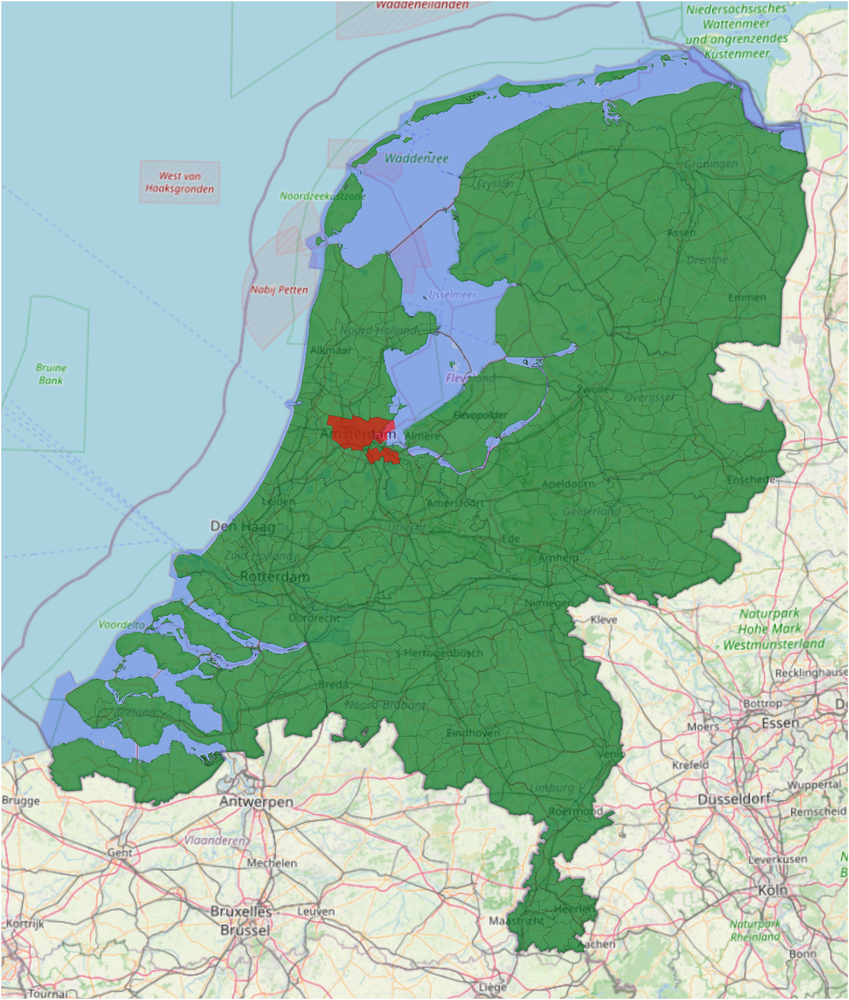

In [9]:
fig, ax = plt.subplots(figsize=(100,100))
muni.plot(ax = ax, color = 'none', zorder = 4, edgecolor = 'black', linewidth = 0.5, alpha = 1)
water_muni.loc[muni['GM_NAAM'] == 'Amsterdam'].plot(ax = ax, color = 'red', zorder = 3, alpha = 0.6)
#muni.loc[muni['GM_NAAM'] == 'Weesp'].plot(ax = ax, color = 'yellow', zorder = 3, alpha = 0.6)
muni.plot(ax = ax, color = 'green', zorder = 2, alpha = 0.6)
gdf.plot(ax = ax, color = 'blue', zorder = 1, alpha = 0.2)
cx.add_basemap(ax = ax, source=cx.providers.OpenStreetMap.Mapnik, crs = gdf.crs, zorder = 0, alpha = 1)
plt.axis('off')
plt.show()

In [14]:
import pandas as pd

#muni = pd.merge(muni, water_muni[['GM_CODE','geometry']], 'left', on = 'GM_CODE', suffixes=('', '_with_water'))
#muni = pd.merge(muni, water[['GM_CODE','geometry']], 'left', on = 'GM_CODE', suffixes=('', '_only_water'))
#muni[['GM_CODE', 'GM_NAAM']].to_csv('GM_codes.csv', index = False)
#muni = gpd.GeoDataFrame(muni, geometry = 'geometry', crs = gdf.crs)



In [18]:
muni = gpd.GeoDataFrame(muni, geometry = 'geometry', crs = gdf.crs)
water = gpd.GeoDataFrame(water, geometry = 'geometry', crs = gdf.crs)
water_muni = gpd.GeoDataFrame(water_muni, geometry = 'geometry', crs = gdf.crs)

In [19]:
muni.to_file('muni.geojson')
water.to_file('water.geojson')
water_muni.to_file('water_muni.geojson')